In [1]:
import os
import h5py
import shutil
from astropy.nddata.utils import Cutout2D
from astropy.io import fits
from astropy import table
import numpy as np
import matplotlib.pyplot as plt
from astropy.visualization import (ZScaleInterval, ImageNormalize)

import csv
import pandas as pd

In [3]:
scratch = os.path.expandvars('$SCRATCH')

In [5]:
hf = h5py.File(scratch + "/testing_create_cuts.h5", "r")

In [25]:
tile_ids = list(hf.keys())

In [39]:
print([i for i in range(12,15)])

[12, 13, 14]


In [40]:
from itertools import chain
concatenated = chain(range(11), range(12, 15))

In [42]:
for i in concatenated: 
    print(i)

0
1
2
3
4
5
6
7
8
9
10
12
13
14


In [26]:
n_cutouts = 0
for i in range(15):
    print(i)
    l = len(hf.get(tile_ids[i] + "/IMAGES"))
    n_cutouts += l
    print(l)
print(n_cutouts)


0
818
1
16590
2
7884
3
23947
4
17315
5
617
6
4513
7
7452
8
239
9
6631
10
23947
11
2088
12
11
13
2497
14
688
115237


In [11]:
print(len(list(hf.keys())))
print(hf.keys())

15
<KeysViewHDF5 ['134.283', '135.283', '136.282', '136.283', '137.282', '148.276', '149.275', '149.276', '150.274', '150.275', '150.276', '151.274', '153.272', '154.271', '157.269']>


In [19]:
img = np.array(hf.get('151.274/IMAGES/c156'))
wgt = np.array(hf.get('151.274/WEIGHTS/c156'))

In [17]:
hf.get('157.269/IMAGES')

<HDF5 group "/157.269/IMAGES" (688 members)>

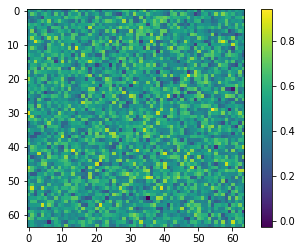

In [66]:
#for i in range(5):
#plt.imshow(img[...,0])
#plt.colorbar()
#plt.show()
plt.imshow(np.random.normal(loc = 0.5,scale= 0.13, size=(64,64,5))[...,0])
plt.colorbar()
#    plt.show()
#    plt.imshow(wgt[...,i])
#    plt.show()

In [2]:
scratch = os.path.expandvars("$SCRATCH") + '/'
image_dir = "/home/anahoban/projects/rrg-kyi/astro/cfis/W3/"
cutout_dir = scratch

In [39]:
tile_list = open(image_dir + "tiles.list", "r")

In [40]:
# makes diff id lists for each channel
tile_list = open(image_dir + "tiles.list", "r")
tile_ids_r = []
tile_ids_u = []
tile_ids_g = []
tile_ids_i = []
tile_ids_z = []

for tile in tile_list:
    tile = tile[:-1] #remove new line character 
    tile_bands = tile.split(" ") 
    if tile_bands == ['']:
        continue
    else:
        for num_band in range(len(tile_bands)):
            if tile_bands[num_band][-1] == 'r':
                tile_ids_r.append(tile_bands[num_band][5:12])
            if tile_bands[num_band][-1] == 'u':
                tile_ids_u.append(tile_bands[num_band][5:12])
            if tile_bands[num_band][-1] == 'g':
                tile_ids_g.append(tile_bands[num_band][4:11])
            if tile_bands[num_band][-1] == 'i':
                tile_ids_i.append(tile_bands[num_band][4:11])
            if tile_bands[num_band][-1] == 'z':
                tile_ids_z.append(tile_bands[num_band][4:11])
tile_list.close()

---

## Shuffle tile numbers

In [63]:
tile_ids_u[:20]

['148.276',
 '149.275',
 '149.276',
 '150.274',
 '150.275',
 '150.276',
 '151.274',
 '151.275',
 '151.276',
 '152.274',
 '152.275',
 '152.276',
 '153.272',
 '153.273',
 '153.274',
 '153.275',
 '153.276',
 '154.271',
 '154.272',
 '154.273']

In [64]:
listid = tile_ids_r[:20]+tile_ids_u[:20]
print(listid)

['134.283', '135.283', '136.282', '136.283', '137.282', '137.283', '138.281', '138.282', '138.283', '139.281', '139.282', '139.283', '140.280', '140.281', '140.282', '140.283', '141.280', '141.281', '141.282', '141.283', '148.276', '149.275', '149.276', '150.274', '150.275', '150.276', '151.274', '151.275', '151.276', '152.274', '152.275', '152.276', '153.272', '153.273', '153.274', '153.275', '153.276', '154.271', '154.272', '154.273']


In [77]:
from random import shuffle
x = [[i] for i in listid]
shuffle(x)

In [78]:
print(x)

[['149.276'], ['136.283'], ['137.282'], ['140.282'], ['136.282'], ['151.274'], ['154.273'], ['140.281'], ['141.280'], ['139.282'], ['153.274'], ['153.275'], ['139.283'], ['138.282'], ['141.282'], ['150.274'], ['153.276'], ['152.275'], ['138.281'], ['149.275'], ['154.272'], ['138.283'], ['141.283'], ['135.283'], ['140.280'], ['151.276'], ['140.283'], ['137.283'], ['150.275'], ['151.275'], ['153.273'], ['141.281'], ['152.276'], ['139.281'], ['148.276'], ['150.276'], ['134.283'], ['154.271'], ['153.272'], ['152.274']]


In [92]:
a = [i[0] for i in x]

In [93]:
a

['149.276',
 '136.283',
 '137.282',
 '140.282',
 '136.282',
 '151.274',
 '154.273',
 '140.281',
 '141.280',
 '139.282',
 '153.274',
 '153.275',
 '139.283',
 '138.282',
 '141.282',
 '150.274',
 '153.276',
 '152.275',
 '138.281',
 '149.275',
 '154.272',
 '138.283',
 '141.283',
 '135.283',
 '140.280',
 '151.276',
 '140.283',
 '137.283',
 '150.275',
 '151.275',
 '153.273',
 '141.281',
 '152.276',
 '139.281',
 '148.276',
 '150.276',
 '134.283',
 '154.271',
 '153.272',
 '152.274']

In [94]:
import csv

f = open(cutout_dir + 'tiles_unbalanced.csv', 'w')

# create the csv writer
writer = csv.writer(f)

# write a row to the csv file
writer.writerow(a)

# close the file
f.close()

In [9]:
with open(cutout_dir + 'tiles_unbalanced.csv', newline='') as f:
    reader = csv.reader(f)
    tile_ids = list(reader)
    

In [10]:
f.close()

In [11]:
tile_ids[0]

['149.276',
 '136.283',
 '137.282',
 '140.282',
 '136.282',
 '151.274',
 '154.273',
 '140.281',
 '141.280',
 '139.282',
 '153.274',
 '153.275',
 '139.283',
 '138.282',
 '141.282',
 '150.274',
 '153.276',
 '152.275',
 '138.281',
 '149.275',
 '154.272',
 '138.283',
 '141.283',
 '135.283',
 '140.280',
 '151.276',
 '140.283',
 '137.283',
 '150.275',
 '151.275',
 '153.273',
 '141.281',
 '152.276',
 '139.281',
 '148.276',
 '150.276',
 '134.283',
 '154.271',
 '153.272',
 '152.274']

In [64]:
print('u    r    g   i  z')
print(len(tile_ids_u),len(tile_ids_r),len(tile_ids_g),len(tile_ids_i),len(tile_ids_z))

u    r    g   i  z
7164 5132 90 89 90


--- 

In [3]:
hf = h5py.File(scratch + "testing_create_cuts.h5", "r")
#hf.close()

In [8]:
#os.remove(os.path.expandvars("$SCRATCH") + "/test.h5")

In [66]:
#intitialize file in tmpdir, to work there
src = os.path.expandvars("$SCRATCH") #+ "/test2.h5"
dest = os.path.expandvars("$SLURM_TMPDIR") + "/"
#shutil.copy2(src, dest)

In [9]:
hf = h5py.File(dest + "test2.h5", "r+")

In [10]:
inorms = []
wnorms = []

In [67]:
def create_cutouts(img, wt, x, y, band):
    ''' Creates the image and weight cutouts given a tile, the position of the center and the band '''
    
    img_cutout = Cutout2D(img.data, (x, y), cutout_size, mode="partial", fill_value=0).data
    if np.count_nonzero(np.isnan(img_cutout)) >= 0.05*cutout_size**2 or np.count_nonzero(img_cutout) == 0: # Don't use this cutout
        return (None, None)
    wt_cutout = Cutout2D(wt.data, (x, y), cutout_size, mode="partial", fill_value=0).data
    img_cutout[np.isnan(img_cutout)] = 0
    wt_cutout[np.isnan(wt_cutout)] = 0
    
    img_lower = np.percentile(img_cutout, 0.001)
    #img_lower = np.min(img_cutout)
    img_upper = np.percentile(img_cutout, 99.999)
    
    img_cutout[img_cutout<img_lower] = img_lower
    img_cutout[img_cutout>img_upper] = img_upper
    
    
    if img_lower == img_upper:
        img_norm = np.zeros((cutout_size, cutout_size))
    else:
        img_norm = (img_cutout - np.min(img_cutout)) / (img_upper - img_lower)
        #inorms.append(1/(img_upper - img_lower))
        
    if band in ["i", "g", 'z']: # Alter weights for PS1
        wt_norm = (wt_cutout - np.min(wt_cutout)) / (img_upper - img_lower)
        #wnorms.append(1/(img_upper - img_lower))
    else: # Do not alter weights for CFIS
        wt_norm = wt_cutout
        
        
    return (img_norm, wt_norm)

In [70]:
u_images = []; u_weights = []
r_images = []; r_weights = []
u_cat = []
r_cat = []

for tile_id in tile_ids_r:
    r_images.append( image_dir + 'CFIS.'+ tile_id + '.r' + ".fits")
    r_weights.append(image_dir + 'CFIS.'+ tile_id + '.r' + ".weight.fits.fz")
    r_cat.append(    image_dir + 'CFIS.'+ tile_id + '.r' + ".cat")     
    
for tile_id in tile_ids_u:
    u_images.append( image_dir + 'CFIS.'+ tile_id + '.u' + ".fits")
    u_weights.append(image_dir + 'CFIS.'+ tile_id + '.u' + ".weight.fits.fz")
    u_cat.append(    image_dir + 'CFIS.'+ tile_id + '.u' + ".cat")

In [71]:
# Copy tiles to $SLURM_TMPDIR
start = 0
end = 20
for n in range(start, end):
    shutil.copy2(u_images[n], dest)
    shutil.copy2(u_weights[n], dest)
    shutil.copy2(r_images[n], dest)
    shutil.copy2(r_weights[n], dest)
    shutil.copy2(u_cat[n], dest)
    shutil.copy2(r_cat[n], dest)
    
    u_images[n] = os.path.abspath(dest + os.path.basename(u_images[n]))
    u_weights[n] = os.path.abspath(dest + os.path.basename(u_weights[n]))
    r_images[n] = os.path.abspath(dest + os.path.basename(r_images[n]))
    r_weights[n] = os.path.abspath(dest + os.path.basename(r_weights[n]))
    u_cat[n] = os.path.abspath(dest + os.path.basename(u_cat[n]))
    r_cat[n] = os.path.abspath(dest + os.path.basename(r_cat[n]))

In [72]:
cutout_size = 64
start = 0
end = 20 #NUMBER OF TILES TAKEN FROM EACH CHANNEL!

img_cutout = np.zeros((cutout_size, cutout_size, 5))
wt_cutout  = np.zeros((cutout_size, cutout_size, 5))

for n in range(start, end):
    u_image  = fits.open(u_images[n], memmap=True)
    u_weight = fits.open(u_weights[n], memmap=True)
    r_image  = fits.open(r_images[n], memmap=True)
    r_weight = fits.open(r_weights[n], memmap=True)
    rcat = table.Table.read(r_cat[n], format="ascii.sextractor")
    ucat = table.Table.read(u_cat[n], format="ascii.sextractor")
    
    #cutouts from r band
    root = os.path.basename(r_images[n])[5:12] + "/" # XXX.XXX id
    
    if root in list(hf.keys()):
        img_group = hf.get(root + "IMAGES")
        wt_group  = hf.get(root + "WEIGHTS")
    else:
        img_group = hf.create_group(root + "IMAGES")
        wt_group  = hf.create_group(root + "WEIGHTS")
    count=0
    for i in range(len(rcat)): #each cutout in tile
        if rcat["FLAGS"][i] != 0 or rcat["MAG_AUTO"][i] >= 99.0 or rcat["MAGERR_AUTO"][i] <= 0 or rcat["MAGERR_AUTO"][i] >= 1:
            continue
        
        x = rcat["X_IMAGE"][i]
        y = rcat["Y_IMAGE"][i]
        
        (r_img, r_wt) = create_cutouts(r_image[0], r_weight[1], x, y, "r")
        if r_img is None:
            continue
            
        #img_cutout[:,:,2] = r_img   
        plt.imshow(r_image)
        #wt_cutout[:,:,2] = r_wt 
        plt.show()
        plt.imshow(r_wt)
        break
        
        #place random gaussian in u channel
        img_cutout[:,:,0] =  np.random.normal(size=(64,64))
        
        img_group.create_dataset(f"c{count}", data=img_cutout)
        wt_group.create_dataset(f"c{count}", data=wt_cutout)
        
        count += 1
        
    r_image.close()
    r_weight.close()
    
    
    count=0
    #cutouts from u band
    root = os.path.basename(u_images[n])[5:12] + "/" # XXX.XXX id
    if root in list(hf.keys()):
        img_group = hf.get(root + "IMAGES")
        wt_group = hf.get(root + "WEIGHTS")
    else:
        img_group = hf.create_group(root + "IMAGES")
        wt_group = hf.create_group(root + "WEIGHTS")
        
    for i in range(len(ucat)): #each cutout in tile
        if ucat["FLAGS"][i] != 0 or ucat["MAG_AUTO"][i] >= 99.0 or ucat["MAGERR_AUTO"][i] <= 0 or ucat["MAGERR_AUTO"][i] >= 1:
            continue
        
        x = ucat["X_IMAGE"][i]
        y = ucat["Y_IMAGE"][i]
        
        (u_img, u_wt) = create_cutouts(u_image[0], u_weight[1], x, y, "u")
        if u_img is None:
            continue
            
        img_cutout[:,:,0] = u_img
        wt_cutout[:,:,0] = u_wt
        
        #place random gaussian in r channel
        img_cutout[:,:,2] =  np.random.normal(size=(64,64))
       
        img_group.create_dataset(f"c{count}", data=img_cutout)
        wt_group.create_dataset(f"c{count}", data=wt_cutout)
        count += 1
    
    u_image.close()
    u_weight.close()
    
    print(f"Tile {n+1} completed")

ValueError: Unable to create group (name already exists)

In [15]:
hf.close()
src = os.path.expandvars("$SLURM_TMPDIR") + "/test2.h5"
dest = os.path.expandvars("$SCRATCH") + "/"
shutil.copy2(src, dest)

'/scratch/anahoban/test2.h5'

In [47]:
print(len(inorms), len(wnorms))

143395 143395


2.3387279018791668e-05 0.08680109709210702


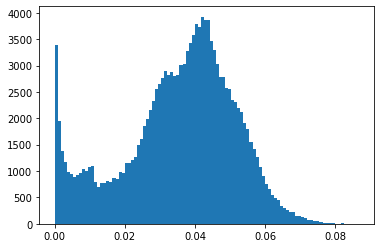

In [48]:
plt.hist(inorms, bins =100);
print(np.min(inorms),np.max(inorms))

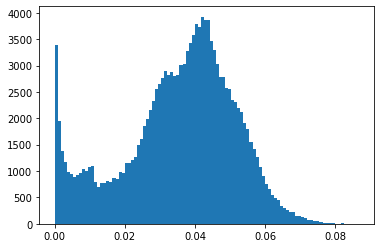

In [49]:
plt.hist(wnorms, bins=100);

--- ---


## Catalogue filtering

In [10]:
cat_r = table.Table.read(r_cat[0], format="ascii.sextractor")

In [18]:
cat_r.keys()

['NUMBER',
 'X_IMAGE',
 'Y_IMAGE',
 'ALPHA_J2000',
 'DELTA_J2000',
 'MAG_AUTO',
 'MAGERR_AUTO',
 'MAG_BEST',
 'MAGERR_BEST',
 'MAG_APER',
 'MAGERR_APER',
 'A_WORLD',
 'ERRA_WORLD',
 'B_WORLD',
 'ERRB_WORLD',
 'THETA_J2000',
 'ERRTHETA_J2000',
 'ISOAREA_IMAGE',
 'MU_MAX',
 'FLUX_RADIUS',
 'FLAGS']

In [17]:
cat_r['FLAGS']

0
3
2
0
8
0
0
18
0
0
0


In [20]:
u_flags = []
r_flags = []

for n in range(0, 20):
    #root = os.path.basename(u_images[n])[5:12] + "/" # XXX.XXX id
    
    cat_r = table.Table.read(r_cat[n], format="ascii.sextractor")
    cat_u = table.Table.read(u_cat[n], format="ascii.sextractor")
    
    for i in range(len(cat_r)): #each cutout in tile
        r_flags.append(cat_r["FLAGS"][i])
        
    for i in range(len(cat_u)): #each cutout in tile
        u_flags.append(cat_u["FLAGS"][i])
    #if main_cat["FLAGS"][i] != 0 or main_cat["MAG_AUTO"][i] >= 99.0 or main_cat["MAGERR_AUTO"][i] <= 0 or main_cat["MAGERR_AUTO"][i] >= 1:
        #continue

(array([1.63493e+05, 1.10000e+01, 0.00000e+00, 4.50400e+03, 2.99000e+02,
        1.80000e+01, 1.00000e+00, 0.00000e+00, 0.00000e+00, 3.00000e+00]),
 array([ 0. ,  5.1, 10.2, 15.3, 20.4, 25.5, 30.6, 35.7, 40.8, 45.9, 51. ]),
 <BarContainer object of 10 artists>)

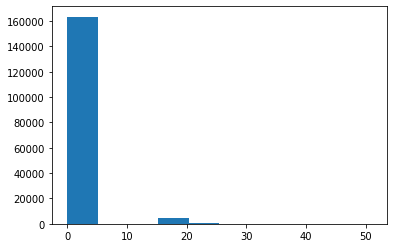

In [29]:
plt.hist(u_flags,)

(array([6.19668e+05, 5.60000e+01, 4.53900e+03, 2.18500e+03, 2.03000e+02,
        6.90000e+01, 0.00000e+00, 5.00000e+00, 1.26000e+02, 7.00000e+00]),
 array([ 0. ,  6.2, 12.4, 18.6, 24.8, 31. , 37.2, 43.4, 49.6, 55.8, 62. ]),
 <BarContainer object of 10 artists>)

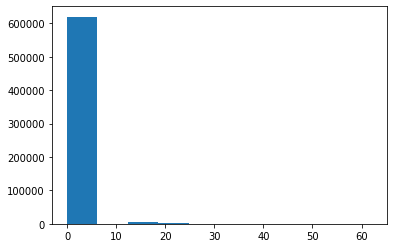

In [28]:
plt.hist(r_flags)

In [7]:
n_cutouts = 0
for i in range(20):
    print(i)
    n = len(hf.get(tile_ids[i] + "/IMAGES"))
    n_cutouts += n
    print(n)
print(n_cutouts)

0
750
1
12701
2
4521
3
17954
4
21958
5
0
6
9812
7
29322
8
5389
9
30480
10
17543
11
22582
12
26076
13
13188
14
0
15
30666
16
23758
17
14357
18
24227
19
27838
333122


---
# Testing jobs

In [1]:
import os
import h5py
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from astropy.visualization import (ZScaleInterval, ImageNormalize)
import tensorflow as tf
from tensorflow import keras
import tensorflow.keras.backend as K
from functions import plot_loss_curves
%load_ext autoreload
from func_job2 import *

In [2]:
cutout_dir = os.path.expandvars("$SCRATCH") + "/"
image_dir = "/home/anahoban/projects/rrg-kyi/astro/cfis/W3/"

In [3]:
# Only use tiles with all five channels
tile_list = open(image_dir + "tiles.list", "r")
tile_ids = []

for tile in tile_list:
    tile = tile[:-1] # Remove new line character
    channels = tile.split(" ")
    if len(channels) == 5: # Order is u,g,r,i,z
        tile_ids.append(channels[0][5:12]) # XXX.XXX id
tile_list.close()

In [3]:
with open(cutout_dir + 'tiles_unbalanced.csv', newline='') as f:
    reader = csv.reader(f)
    data  = list(reader)
f.close()

tile_ids = data[0]

In [4]:
hf = h5py.File(cutout_dir + "test.h5", "r")

In [5]:
BATCH_SIZE = 256 #128
CUTOUT_SIZE = 64
N_EPOCHS = 10

In [7]:
def get_test_cutouts(index, n_cutouts, cutout_size, bands="cfis", start=0):
    n = 0
    if bands == "all":
        band_indices = [0, 1, 2, 3, 4]
        l = len(band_indices)
        sources = np.zeros((n_cutouts, cutout_size, cutout_size, l))
        weights = np.zeros((n_cutouts, cutout_size, cutout_size, l))
        
        
    elif bands == "cfis":
        band_indices = [0,2]
        l = len(band_indices)
        sources = np.zeros((n_cutouts, cutout_size, cutout_size, l))
        weights = np.zeros((n_cutouts, cutout_size, cutout_size, l))
        
    else: # PS1
        band_indices = [1, 3, 4]
        l = len(band_indices)
        sources = np.zeros((n_cutouts, cutout_size, cutout_size, l))
        weights = np.zeros((n_cutouts, cutout_size, cutout_size, l))
        
    img_group = hf.get(tile_ids[index] + "/IMAGES")
    wt_group = hf.get(tile_ids[index] + "/WEIGHTS")
    for i in range(start, len(img_group)):
        sources[n,:,:,:] = np.array(img_group.get(f"c{i}"))[:,:,band_indices]
        weights[n,:,:,:] = np.array(wt_group.get(f"c{i}"))[:,:,band_indices]
        n += 1
        if n == n_cutouts:
            #return sources #if no weights
            return np.concatenate((sources, weights),axis=-1) #if we train with weights

In [8]:
test_index = 20
sources_test_cfis = get_test_cutouts(test_index, 50, CUTOUT_SIZE, "cfis")
sources_test_cfis.shape

(50, 64, 64, 4)

In [54]:
tile_ids[36]

'134.283'

134.283


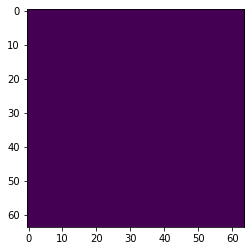

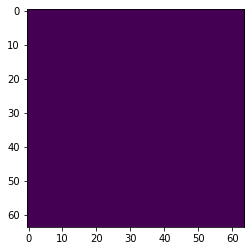

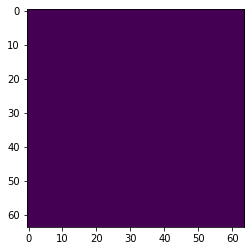

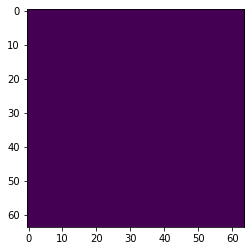

In [58]:
index = 36
n = 50
cut = f"c{n}"
print(tile_ids[index])
plt.imshow(np.array(hf.get(tile_ids[index]+"/IMAGES/" + cut))[...,0])
plt.show()
plt.imshow(np.array(hf.get(tile_ids[index]+"/WEIGHTS/" + cut))[...,0])
plt.show()
plt.imshow(np.array(hf.get(tile_ids[index]+"/IMAGES/" + cut))[...,1])
plt.show()

plt.imshow(np.array(hf.get(tile_ids[index]+"/WEIGHTS/" + cut))[...,1])

In [9]:
bands=2
def MSE_with_uncertainty(y_true, y_pred): 
    weights = y_pred[...,bands:] 
    y_pred_image = y_pred[...,:bands]
    
    return K.square(tf.math.multiply((y_true - y_pred_image), weights) ) #no weights

In [8]:
autoencoder_cfis = create_autoencoder2((CUTOUT_SIZE, CUTOUT_SIZE, bands)) #last is the number of channels
autoencoder_cfis.compile(optimizer="adam", loss=MSE_with_uncertainty)

NameError: name 'CUTOUT_SIZE' is not defined

In [9]:
autoencoder_cfis6 = keras.models.load_model("../Models/job6", custom_objects={'MSE_with_uncertainty': MSE_with_uncertainty})
#or
#autoencoder_cfis.load_weights("../Models/autoencoder_cfis_128p_job3")

In [10]:
autoencoder_cfis7 = keras.models.load_model("../Models/job7", custom_objects={'MSE_with_uncertainty': MSE_with_uncertainty})
#or

In [11]:
history_cfis = pd.read_csv("../Histories/job7.csv")

In [12]:
autoencoder_cfis

In [30]:
decoded_imgs_cfis = autoencoder_cfis7.predict(sources_test_cfis)
residuals_cfis = sources_test_cfis - decoded_imgs_cfis

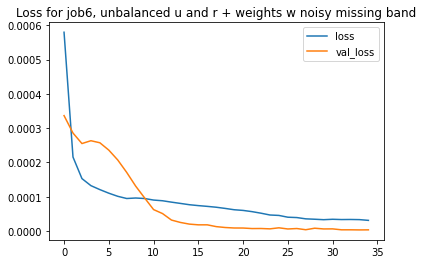

In [12]:
plt.plot(range(35),history_cfis['loss'],label ='loss')
plt.plot(range(35),history_cfis['val_loss'], label = 'val_loss')
plt.legend()
plt.title('Loss for job6, unbalanced u and r + weights w noisy missing band')
plt.savefig('../Loss Curves/job7')

In [15]:
def plot_images(images_true, images_pred, images_res, bands, figname):
    n = len(bands)
    fig,axes = plt.subplots(images_true.shape[0], len(bands)*4, figsize =(30,200))
    plt.setp(axes, xticks=[], yticks=[])
    
    for img in range(images_true.shape[0]):
        for bd in range(len(bands)):
            norm_true  = ImageNormalize(images_true[img,:,:,bd], interval=ZScaleInterval())
            norm_pred  = ImageNormalize(images_pred[img,:,:,bd], interval=ZScaleInterval())
            
            weighted_res = images_res[img,:,:,bd]*images_true[img,:,:,bd+1*n]
            norm_wres  = ImageNormalize(weighted_res, interval=ZScaleInterval())
            
            imw = axes[img][bd].imshow(images_true[img,:,:,bd+1*n])
            im1 = axes[img][bd+1*n].imshow(images_true[img,:,:,bd], norm = norm_true)
            im2 = axes[img][bd+2*n].imshow(images_pred[img,:,:,bd], norm = norm_pred)
            im3 = axes[img][bd+3*n].imshow(weighted_res, norm = norm_wres)

            if img == 0:
                axes[img][bd].set_title(bands[bd])                
                axes[img][bd].set_title(bands[bd])
                axes[img][bd+1*n].set_title(bands[bd])                
                axes[img][bd+2*n].set_title(bands[bd])
                axes[img][bd+3*n].set_title(bands[bd])                
                axes[img][bd+1*n].set_title(bands[bd])                
                axes[img][bd+2*n].set_title(bands[bd])
                axes[img][bd+3*n].set_title(bands[bd])      
    plt.savefig("../Plots/" + figname)

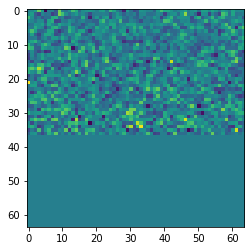

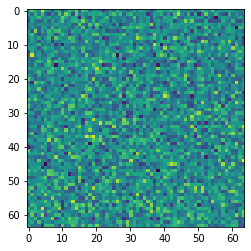

In [25]:
plt.imshow(sources_test_cfis[0,...,0])
plt.show()
plt.imshow(np.random.normal(size=(64,64)))

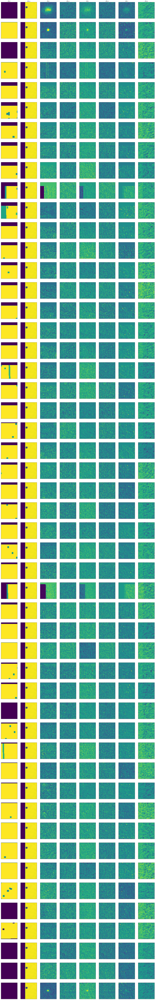

In [31]:
bands = ['cfis r','cfis u']
plot_images(sources_test_cfis[...], decoded_imgs_cfis[...], residuals_cfis[...], bands, figname = 'job7_test')

---
# Testing wb

In [3]:
import wandb
import os

In [13]:
with open(cutout_dir + 'tiles_unbalanced.csv', newline='') as f:
    reader = csv.reader(f)
    data  = list(reader)
f.close()

tile_ids = data[0]

In [ ]:
#cutouts file
hf = h5py.File(cutout_dir + "test.h5", "r")

In [ ]:
cutout_dir = os.path.expandvars("$SCRATCH") + '/'
image_dir = "/home/anahoban/projects/rrg-kyi/astro/cfis/W3/"

In [2]:
#login 
wandb.login()

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: You can find your API key in your browser here: https://wandb.ai/authorize


wandb: Paste an API key from your profile and hit enter:  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /home/anahoban/.netrc


True

In [5]:
os.getenv('WANDB_NOTEBOOK_NAME')
os.environ['WANDB_NOTEBOOK_NAME'] = 'test'

In [20]:
def train_auto(hf, tile_ids, model, train_indices, val_indices, n_epochs, batch_size, cutout_size, all_callbacks = None, bands="all"):
    n_cutouts_train = 0
    for i in train_indices:
        img_group = hf.get(tile_ids[i] + "/IMAGES")   
        n_cutouts_train += len(img_group)
    
    n_cutouts_val = 0    
    for i in val_indices:
        img_group = hf.get(tile_ids[i] + "/IMAGES")        
        n_cutouts_val += len(img_group)
    
    train_steps = n_cutouts_train // batch_size
    val_steps = n_cutouts_val // batch_size
    
    history = model.fit(get_cutouts(hf, tile_ids, train_indices, batch_size, cutout_size, bands), 
                        epochs=n_epochs, steps_per_epoch=train_steps, 
                        validation_data=get_cutouts(hf, tile_ids, val_indices, batch_size, cutout_size, bands), 
                        validation_steps=val_steps, callbacks= all_callbacks)
    
    # log metrics using wandb.log
    wandb.log({'epochs': range(n_epochs),
                   'loss': history.history['loss'], 
                   'val_loss': history.history['val_loss']})
    return model, history

In [21]:
##TRAINING PREP##
BATCH_SIZE  = 256 
CUTOUT_SIZE = 64
N_EPOCHS    = 2 
configs = {
              "epochs": 2,
              "batch_size": 256,
              "cutout_size": 54,
              "architecture": "CNN",
              "dataset": "test"
           }
run = wandb.init(project='my-tf-integration', entity = 'mizar', config=configs)
config = wandb.config

# tiles for val and training
train_indices = range(1)
val_indices = [2]

#autosave
model_checkpoint_file = "../Models/job8.h5"
model_checkpoint_callback = ModelCheckpoint(model_checkpoint_file, monitor='val_loss', mode='min',verbose=1, save_best_only=True)


#training
bands = 2
autoencoder_cfis = create_autoencoder2((CUTOUT_SIZE, CUTOUT_SIZE, bands*2)) #last is the number of channels
autoencoder_cfis.compile(optimizer="adam", loss=MSE_with_uncertainty)

(autoencoder_cfis, history_cfis) = train_auto(hf, tile_ids, autoencoder_cfis, train_indices,  val_indices, batch_size=BATCH_SIZE, cutout_size=CUTOUT_SIZE, n_epochs= N_EPOCHS, all_callbacks = [model_checkpoint_callback], bands="cfis")

hf.close()

run.join()

Epoch 1/2
10/10 [==============================] - ETA: 0s - loss: 1.8568e-04
Epoch 00001: val_loss improved from inf to 0.00049, saving model to ../Models/job8.h5
10/10 [==============================] - 81s 8s/step - loss: 1.8568e-04 - val_loss: 4.9487e-04
Epoch 2/2
10/10 [==============================] - ETA: 0s - loss: 5.0500e-05
Epoch 00002: val_loss improved from 0.00049 to 0.00049, saving model to ../Models/job8.h5
10/10 [==============================] - 58s 6s/step - loss: 5.0500e-05 - val_loss: 4.9157e-04


TypeError: Object of type range is not JSON serializable

In [ ]:
# 3. Log metrics over time to visualize performance
with tf.Session() as sess:
  # ...
  wandb.tensorflow.log(tf.summary.merge_all())